In [301]:
import pandas as pd 
import datetime
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import plotly.express as px
plt.style.use('ggplot')

In [302]:
df = pd.read_csv(
    'ChargePoint Data CY20Q4.csv', dtype={'Station Name': str}, 
    parse_dates=['Start Date'], infer_datetime_format=True, low_memory=False)

# Make a unique id for each row
df['Id'] = df.index
# Drop columns that are not needed
df.drop(
    ['User ID', 'County', 'City', 'Postal Code', 'Driver Postal Code',
    'State/Province', 'Fee', 'Currency', 'EVSE ID', 'Transaction Date (Pacific Time)',
    'GHG Savings (kg)', 'Gasoline Savings (gallons)', 'Org Name'
    'Address 1', 'System S/N', 'Plug In Event Id', 'Ended By',
    'End Time Zone', 'Start Time Zone', 'Country', 'Model Number'
    ], axis=1, inplace=True)

df.isna().sum()

Station Name                 0
MAC Address                  0
Org Name                     0
Start Date                   0
End Date                     0
Total Duration (hh:mm:ss)    0
Charging Time (hh:mm:ss)     0
Energy (kWh)                 0
Port Type                    9
Port Number                  0
Plug Type                    0
Latitude                     0
Longitude                    0
dtype: int64

In [303]:
# There's Excel formatting in the End Data column, so we need to convert from Excel serial to datetime
# https://stackoverflow.com/questions/6706231/fetching-datetime-from-float-in-python
def convert_to_datetime(serial):
    try:
        return pd.to_datetime(serial)
    except:
        seconds = (float(serial) - 25569) * 86400.0
        return datetime.datetime.utcfromtimestamp(seconds)

df['End Date'] = df['End Date'].apply(convert_to_datetime)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259415 entries, 0 to 259414
Data columns (total 13 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Station Name               259415 non-null  object        
 1   MAC Address                259415 non-null  object        
 2   Org Name                   259415 non-null  object        
 3   Start Date                 259415 non-null  datetime64[ns]
 4   End Date                   259415 non-null  datetime64[ns]
 5   Total Duration (hh:mm:ss)  259415 non-null  object        
 6   Charging Time (hh:mm:ss)   259415 non-null  object        
 7   Energy (kWh)               259415 non-null  float64       
 8   Port Type                  259406 non-null  object        
 9   Port Number                259415 non-null  int64         
 10  Plug Type                  259415 non-null  object        
 11  Latitude                   259415 non-null  float64 

## Create clusters based on Station Names

In [304]:
print("Number of unique stations:", df['Station Name'].nunique())
df['Cluster'] = df['Station Name'].str.split(' ').str[4]
print(df['Cluster'].value_counts())

Number of unique stations: 47
BRYANT       47100
HIGH         39901
HAMILTON     38609
WEBSTER      37585
CAMBRIDGE    32879
MPL          28326
RINCONADA    18264
TED          16712
SHERMAN         39
Name: Cluster, dtype: int64


## Plot the stations on a map

In [305]:
# plot the geographical distribution of the charging stations
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

[]

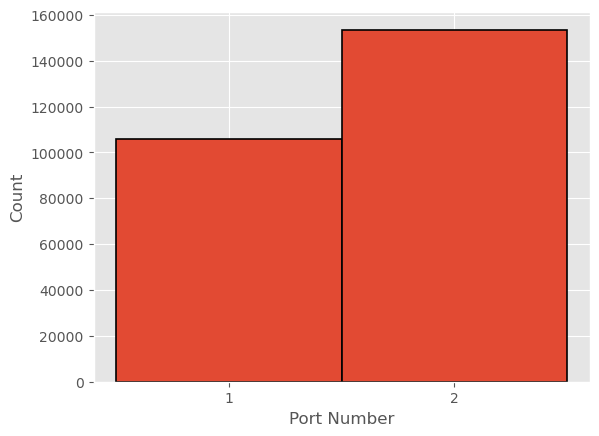

In [ ]:
bins = np.arange(1, df['Port Number'].max() + 1.5) - 0.5
# then you plot away
fig, ax = plt.subplots()
_ = ax.hist(df['Port Number'], bins, edgecolor='k', linewidth=1.2)
ax.set_xticks(bins + 0.5)
ax.set_xlabel('Port Number')
ax.set_ylabel('Count')
plt.plot()

In [309]:
test_df = df[df['Cluster'] == 'WEBSTER']
test_df.sort_values(by='Start Date').head(10)

,Station Name,MAC Address,Org Name,Start Date,End Date,Total Duration (hh:mm:ss),Charging Time (hh:mm:ss),Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Cluster
40632,PALO ALTO CA / WEBSTER #1,0024B10000021146,City of Palo Alto,2015-07-29 13:59:00,2015-07-29 17:44:00,3:45:04,2:14:24,6.787040,Level 2,2,J1772,37.449348,-122.157768,WEBSTER
40643,PALO ALTO CA / WEBSTER #1,0024B10000021146,City of Palo Alto,2015-07-29 16:32:00,2015-07-29 16:54:00,0:21:55,0:20:49,2.050624,Level 2,1,J1772,37.449348,-122.157768,WEBSTER
40645,PALO ALTO CA / WEBSTER #2,0024B100000207FA,City of Palo Alto,2015-07-29 16:53:00,2015-07-29 17:27:00,0:33:56,0:33:29,3.219851,Level 2,2,J1772,37.449375,-122.157799,WEBSTER
40652,PALO ALTO CA / WEBSTER #1,0024B10000021146,City of Palo Alto,2015-07-29 18:24:00,2015-07-29 20:58:00,2:34:30,2:33:20,9.449517,Level 2,2,J1772,37.449348,-122.157768,WEBSTER
40654,PALO ALTO CA / WEBSTER #1,0024B10000021146,City of Palo Alto,2015-07-29 18:46:00,2015-07-29 20:34:00,1:48:13,1:26:49,8.949968,Level 2,1,J1772,37.449348,-122.157768,WEBSTER
40656,PALO ALTO CA / WEBSTER #2,0024B100000207FA,City of Palo Alto,2015-07-29 19:07:00,2015-07-29 21:20:00,2:13:41,2:13:20,6.898466,Level 2,2,J1772,37.449375,-122.157799,WEBSTER
40658,PALO ALTO CA / WEBSTER #2,0024B100000207FA,City of Palo Alto,2015-07-29 19:28:00,2015-07-29 23:24:00,3:56:14,2:47:56,16.237156,Level 2,1,J1772,37.449375,-122.157799,WEBSTER
40662,PALO ALTO CA / WEBSTER #1,0024B10000021146,City of Palo Alto,2015-07-29 20:55:00,2015-07-29 22:28:00,1:32:56,1:31:39,4.723608,Level 2,1,J1772,37.449348,-122.157768,WEBSTER
40675,PALO ALTO CA / WEBSTER #1,0024B10000021146,City of Palo Alto,2015-07-30 07:29:00,2015-07-30 14:06:00,6:37:15,3:36:09,20.734360,Level 2,2,J1772,37.449348,-122.157768,WEBSTER
40680,PALO ALTO CA / WEBSTER #2,0024B100000207FA,City of Palo Alto,2015-07-30 08:12:00,2015-07-30 10:10:00,1:58:27,1:58:10,6.133974,Level 2,2,J1772,37.449375,-122.157799,WEBSTER


In [324]:
test_df['Period'] = [pd.date_range(s, e, freq='T') for s, e in zip(test_df['Start Date'], test_df['End Date'])]
res = test_df.explode('Period').groupby(pd.Grouper(key='Period', freq='60T'))['Energy (kWh)'].nunique()
# rename energy to sessions
res.rename('Sessions', inplace=True)

/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_22567/1402409397.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Period
2015-07-29 13:00:00    1
2015-07-29 14:00:00    1
2015-07-29 15:00:00    1
2015-07-29 16:00:00    3
2015-07-29 17:00:00    2
                      ..
2020-12-31 17:00:00    2
2020-12-31 18:00:00    2
2020-12-31 19:00:00    2
2020-12-31 20:00:00    2
2020-12-31 21:00:00    1
Name: Sessions, Length: 47577, dtype: int64

In [362]:
data = res.to_frame()
data = data.reset_index()
data.Period = pd.to_datetime(data.Period)
print(data.info())
data["Cluster"] = "WEBSTER"
data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47577 entries, 0 to 47576
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    47577 non-null  datetime64[ns]
 1   Sessions  47577 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 743.5 KB
None


,Period,Sessions,Cluster
0,2015-07-29 13:00:00,1,WEBSTER
1,2015-07-29 14:00:00,1,WEBSTER
2,2015-07-29 15:00:00,1,WEBSTER
3,2015-07-29 16:00:00,3,WEBSTER
4,2015-07-29 17:00:00,2,WEBSTER
...,...,...,...
47572,2020-12-31 17:00:00,2,WEBSTER
47573,2020-12-31 18:00:00,2,WEBSTER
47574,2020-12-31 19:00:00,2,WEBSTER
47575,2020-12-31 20:00:00,2,WEBSTER


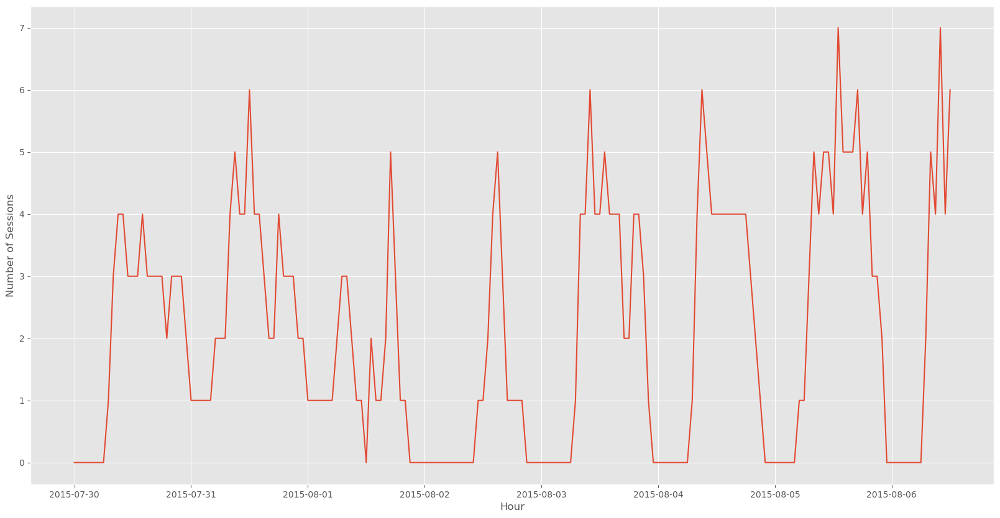

In [361]:
fig, ax = plt.subplots(figsize=(20, 10))
ax.plot(res.iloc[11:24+24*7])
# Make y-axis integral
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.set_xlabel('Hour')
ax.set_ylabel('Number of Sessions')
plt.show()